# Mouse Hippocampus Analysis

In [1]:
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import scanpy as sc
import squidpy as sq

import os.path as osp
import os
from PIL import Image

import anndata as ad
import pandas as pd
import numpy as np
from numpy.testing import assert_allclose
import sys
import random
from sklearn import preprocessing
from sklearn.gaussian_process import GaussianProcessRegressor as gpr
import anndata
import eggplant as eg
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
import math
import cv2
import thinplate as tps

import torch
import torch.nn as nn
import torch.nn.init as init
import torch.nn.functional as F
import torch.optim as optim

from torch_geometric.nn import GAE
from torch_geometric.data import Data
from torch_geometric.nn import GCNConv

from scipy.spatial import Delaunay
from scipy.spatial.distance import cdist
import networkx as nx
from collections import defaultdict
import scipy.sparse as sp

import gpytorch
from gpytorch.means import ConstantMean
from gpytorch.distributions import MultivariateNormal
from gpytorch.mlls import ExactMarginalLogLikelihood
from gpytorch.models import ApproximateGP
from gpytorch.variational import VariationalStrategy, CholeskyVariationalDistribution
from gpytorch.kernels import ScaleKernel, RBFKernel
import h5py

from matplotlib.colors import BoundaryNorm
import matplotlib as mpl
from sklearn.cluster import KMeans

# Data preprocessing

In [ ]:
d1 = pd.read_csv('data_hippo/Puck_200115_08_bead_locations.csv')
df1_location=d1[["xcoord","ycoord"]]
df1_location=np.array(df1_location)
df1_barcode_names=pd.DataFrame(index=d1["barcodes"])

data=open("data_hippo/Puck_200115_08.digital_expression.txt")
df1_barcode=data.readline()
df1=data.readlines()
data.close()
print(1)

df1_gene_names=[]
for i in range(df1.__len__()):
    df1[i]=df1[i].split("\t")
    df1_gene_names.append(df1[i][0])
    del(df1[i][0])
    df1[i]=[int(x) for x in df1[i]]
print(1)

df1=np.matrix(df1)
df1=df1.T
df1=np.array(df1)
df1_gene_names=pd.DataFrame(index=df1_gene_names)

data_slice1 = anndata.AnnData(X=df1, obs=df1_barcode_names,var=df1_gene_names)
data_slice1.obsm["spatial"] = df1_location

In [ ]:
d2 = pd.read_csv('data_hippo/Puck_191204_01_bead_locations.csv')
df2_location=d2[["xcoord","ycoord"]]
df2_location=np.array(df2_location)
df2_barcode_names=pd.DataFrame(index=d2["barcodes"])

data=open("data_hippo/Puck_191204_01.digital_expression.txt")
df2_barcode=data.readline()
df2_barcode=data.readline()
df2_barcode=data.readline()
df2_barcode=data.readline()
df2=data.readlines()
data.close()
print(1)

df2_gene_names=[]
for i in range(df2.__len__()):
    df2[i]=df2[i].split("\t")
    df2_gene_names.append(df2[i][0])
    del(df2[i][0])
    df2[i]=[int(x) for x in df2[i]]
print(1)

df2=np.matrix(df2)
df2=df2.T
df2=np.array(df2)
df2_gene_names=pd.DataFrame(index=df2_gene_names)

data_slice2 = anndata.AnnData(X=df2, obs=df2_barcode_names,var=df2_gene_names)
data_slice2.obsm["spatial"] = df2_location

In [ ]:
data_slice1=data_slice1[data_slice1.obsm['spatial'][:,0]>800]
data_slice1=data_slice1[data_slice1.obsm['spatial'][:,1]>700]
data_slice1=data_slice1[data_slice1.obsm['spatial'][:,1]<1.5*data_slice1.obsm['spatial'][:,0]+3000]
data_slice1=data_slice1[data_slice1.obsm['spatial'][:,1]>data_slice1.obsm['spatial'][:,0]-4000]
data_slice1=data_slice1[data_slice1.obsm['spatial'][:,1]<0.5*data_slice1.obsm['spatial'][:,0] + 4250]

data_slice2=data_slice2[data_slice2.obsm['spatial'][:,1]>3000-data_slice2.obsm['spatial'][:,0]]
data_slice2=data_slice2[data_slice2.obsm['spatial'][:,1]<4000+data_slice2.obsm['spatial'][:,0]]
data_slice2=data_slice2[data_slice2.obsm['spatial'][:,1]>700]

In [ ]:
data_slice3= sc.read_visium('data_hippo/hippo-visium')
crd = data_slice3.obsm["spatial"]

x = 4510
y = 3830
r = 2100

keep = []
for ii in range(len(crd)):
    r2 = (crd[ii, 0] - x) ** 2 + (crd[ii, 1] - y) ** 2
    if r2 <= r**2:
        keep.append(ii)
keep = np.array(keep)
data_slice3 = data_slice3[keep, :]
df3_location = data_slice3.obsm['spatial']
obs3=data_slice3.obs_names
var3=data_slice3.var_names
data_slice3 = anndata.AnnData(X=np.array(data_slice3.X.todense()))
data_slice3.obs_names=obs3
data_slice3.var_names=var3
data_slice3.obsm["spatial"] = df3_location

In [ ]:
def process_data(adata, n_top_genes=2000):
    adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.match("^MT|^mt|^Mt")
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
    sc.pp.filter_genes(adata, min_cells=10)
    adata.layers["counts"] = adata.X.copy()
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(
        adata, flavor="seurat", n_top_genes=n_top_genes, subset=True
    )
    return adata

data_slice1 = process_data(data_slice1, n_top_genes=3000)
data_slice2 = process_data(data_slice2, n_top_genes=3000)
data_slice3 = process_data(data_slice3, n_top_genes=3000)

Genes that present in all three samples are retained

In [ ]:
data_slice1_index=[]
data_slice2_index=[]
data_slice3_index=[]
for i in range(data_slice1.shape[1]):
    if(data_slice1.var_names[i] in data_slice2.var_names):
        if(data_slice1.var_names[i] in data_slice3.var_names):
            data_slice1_index.append(i)
            data_slice2_index.append(np.where(data_slice2.var_names==data_slice1.var_names[i])[0][0])
            data_slice3_index.append(np.where(data_slice3.var_names==data_slice1.var_names[i])[0][0])

data_slice1=data_slice1[:,data_slice1_index]
data_slice2=data_slice2[:,data_slice2_index]
data_slice3=data_slice3[:,data_slice3_index]

In [ ]:
sc.tl.pca(data_slice1, svd_solver='arpack')
sc.tl.pca(data_slice2, svd_solver='arpack')
sc.tl.pca(data_slice3, svd_solver='arpack')

Save the data and use Profast(R) to get the embedding of each spots.

In [ ]:
data_slice1_X=pd.DataFrame(data_slice1.layers["counts"])
data_slice2_X=pd.DataFrame(data_slice2.layers["counts"])
data_slice3_X=pd.DataFrame(data_slice3.layers["counts"])
data_slice1_X.index=data_slice1.obs_names
data_slice2_X.index=data_slice2.obs_names
data_slice3_X.index=data_slice3.obs_names
data_slice1_X.columns=data_slice1.var_names
data_slice2_X.columns=data_slice2.var_names
data_slice3_X.columns=data_slice3.var_names

pd.DataFrame(data_slice1_X).to_csv('data_hippo/data_slice1_X.csv',header=True, index=True)
pd.DataFrame(data_slice2_X).to_csv('data_hippo/data_slice2_X.csv',header=True, index=True)
pd.DataFrame(data_slice3_X).to_csv('data_hippo/data_slice3_X.csv',header=True, index=True)
pd.DataFrame(data_slice1.obsm['spatial']).to_csv('data_hippo/data_slice1_spatial.csv',header=False, index=False)
pd.DataFrame(data_slice2.obsm['spatial']).to_csv('data_hippo/data_slice2_spatial.csv',header=False, index=False)
pd.DataFrame(data_slice3.obsm['spatial']).to_csv('data_hippo/data_slice3_spatial.csv',header=False, index=False)

data_slice1.write_h5ad('data_hippo/data_slice1.h5ad')
data_slice2.write_h5ad('data_hippo/data_slice2.h5ad')
data_slice3.write_h5ad('data_hippo/data_slice3.h5ad')

# Read the processed data

In [2]:
data_slice1=sc.read_h5ad('data_hippo/data_slice1.h5ad')
data_slice2=sc.read_h5ad('data_hippo/data_slice2.h5ad')
data_slice3=sc.read_h5ad('data_hippo/data_slice3.h5ad')

In [3]:
embedding1=pd.read_csv('data_hippo/embedding1.csv')
embedding2=pd.read_csv('data_hippo/embedding2.csv')
embedding3=pd.read_csv('data_hippo/embedding3.csv')

In [4]:
data_slice1.obsm['embedding']=np.array(embedding1.T)
data_slice2.obsm['embedding']=np.array(embedding2.T)
data_slice3.obsm['embedding']=np.array(embedding3.T)

In [5]:
print(data_slice1)
print(data_slice2)
print(data_slice3)

AnnData object with n_obs × n_vars = 18728 × 897
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca', 'spatial', 'embedding'
    varm: 'PCs'
    layers: 'counts'
AnnData object with n_obs × n_vars = 9343 × 897
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    v

Text(0.5, 1.0, 'slice_3')

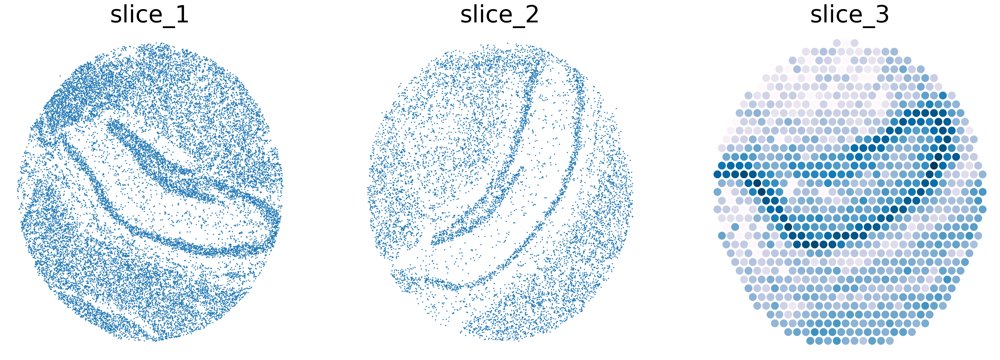

In [6]:
plt.figure(dpi=150,figsize=(30,10))
plt.subplot(1,3, 1)
plt.scatter(np.array(data_slice1.obsm['spatial'][:,0]),
            np.array(data_slice1.obsm['spatial'][:,1]),
            s = 1)
plt.axis("off")
plt.title("slice_1",fontsize=40)

plt.subplot(1,3, 2)
plt.scatter(np.array(data_slice2.obsm['spatial'][:,0]),
            np.array(data_slice2.obsm['spatial'][:,1]),
            s = 1,
            )
plt.axis("off")
plt.title("slice_2",fontsize=40)

plt.subplot(1,3, 3)
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 150)
plt.axis("off")
plt.title("slice_3",fontsize=40)

# Transfer gene information from data_slice1 to data_slice3

## Selecting landmarks

We use 50x50 grid to raster the data.

In [7]:
def Rasterization(data,nx=30,ny=30):
    x=data.obsm['spatial'][:,0]
    y=data.obsm['spatial'][:,1]
    minx=np.min(x)
    maxx=np.max(x)
    miny=np.min(y)
    maxy=np.max(y)

    dx=(maxx-minx)/nx
    dy=(maxy-miny)/ny
    spatial=np.zeros([1,2])
    gene=np.zeros([1,data.obsm['embedding'].shape[1]])
    
    for i in range(nx):
        for j in range(ny):
            xmi=minx+i*dx
            xma=minx+(i+1)*dx
            
            ymi=miny+j*dy
            yma=miny+(j+1)*dy
            
            xarray=np.where((x>=xmi) & (x<xma))[0]
            yarray=np.where((y>=ymi) & (y<yma))[0]
            
            gene1=np.zeros([1,data.obsm['embedding'].shape[1]])
            spatial1=np.zeros([1,2])
            if(xarray.shape[0]!=0 and yarray.shape[0]!=0):
                for m in xarray:
                    if(m in yarray):
                        gene1=np.vstack((gene1,data.obsm['embedding'][m,:]))
                        spatial1=np.vstack((spatial1,data.obsm['spatial'][m,:]))
            if(gene1.shape[0]>1):
                gene1=np.delete(gene1, 0, 0)
                gene1=np.mean(gene1,axis=0)
                spatial1=np.delete(spatial1, 0, 0)
                spatial1=np.mean(spatial1,axis=0)
                spatial=np.vstack((spatial,spatial1))
                gene=np.vstack((gene,gene1))
    spatial=np.delete(spatial, 0, 0)
    gene=np.delete(gene, 0, 0)
    
    return spatial, gene

In [8]:
spatial_new1, gene1=Rasterization(data_slice1,nx=50,ny=50)
spatial_new3=data_slice3.obsm['spatial']
gene3=data_slice3.obsm['embedding']

In [9]:
cor13=np.corrcoef(gene1,gene3)[range(0,gene1.shape[0]),:][:,range(gene1.shape[0],gene1.shape[0]+gene3.shape[0])]

Use the embedding correlation of each spot. The top-ranked spots will be selected as alternate landmarks.

In [10]:
cell1_13=[]
cell3_13=[]
D=cor13.copy()
for i in range(80):
    cloc=np.where(D==np.max(cor13))
    cell1_13.append(cloc[0][0])
    cell3_13.append(cloc[1][0])
    dloc=np.where(cor13==np.max(cor13))
    cor13=np.delete(cor13, dloc[0][0], axis=0)
    cor13=np.delete(cor13, dloc[1][0], axis=1)

In [11]:
lm1_1=spatial_new1[cell1_13,:]
lm3_3=spatial_new3[cell3_13,:]

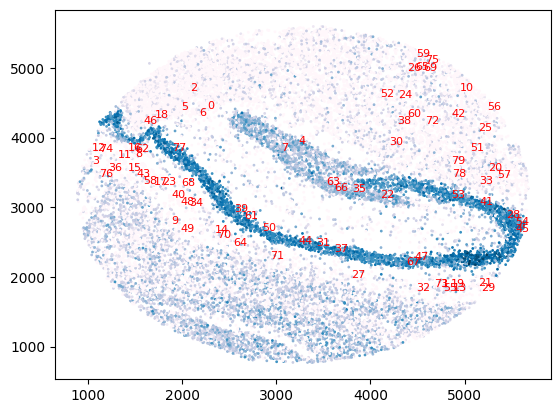

In [12]:
plt.scatter(np.array(data_slice1.obsm["spatial"][:,0]),
            np.array(data_slice1.obsm["spatial"][:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 1)
for i in range(lm1_1.shape[0]):
    plt.text(lm1_1[i,0],lm1_1[i,1],f'{i}', c='red',fontsize=8)

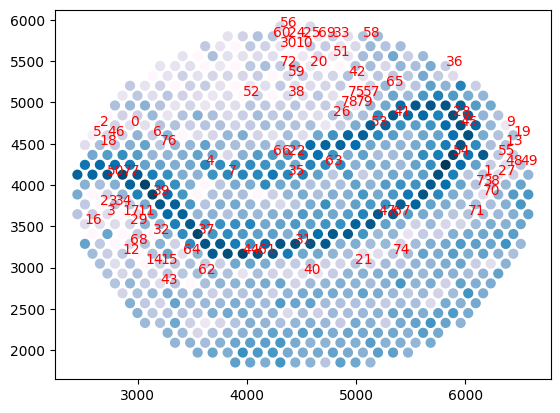

In [13]:
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
for i in range(lm3_3.shape[0]):
    plt.text(lm3_3[i,0],lm3_3[i,1],f'{i}', c='red')

In [14]:
lm50_1=lm1_1[[7,35,53,47,64,77],:]
lm50_3=lm3_3[[7,35,53,47,64,77],:]


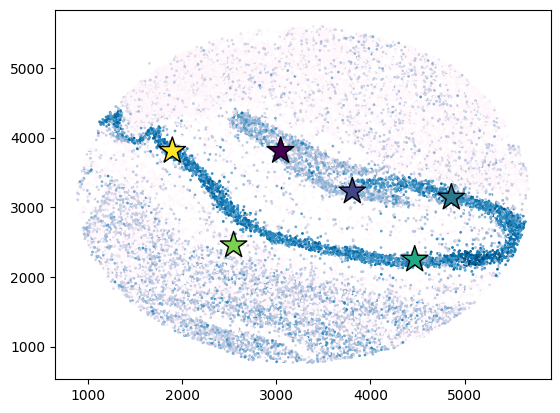

In [15]:
plt.scatter(np.array(data_slice1.obsm["spatial"][:,0]),
            np.array(data_slice1.obsm["spatial"][:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 1)
plt.scatter(lm50_1[:,0],
            lm50_1[:,1],
            s = 400,
            c=range(lm50_1.shape[0]),
            marker = "*",
            edgecolor = "black")


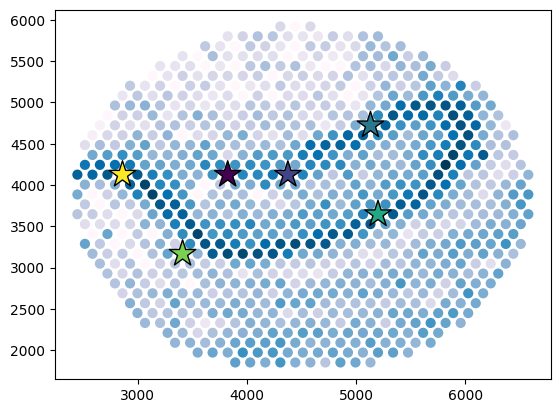

In [16]:
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
plt.scatter(lm50_3[:,0],
            lm50_3[:,1],
            s = 400,
            c=range(lm50_3.shape[0]),
            marker = "*",
            edgecolor = "black")


In [17]:
lm1=lm50_1
lm3=lm50_3

## Spatial alignment

### Rigid alignment

In [18]:
one=np.ones(lm1.shape[0])
lm1_1=np.insert(lm1,2,one,axis=1)
M1=np.dot(np.dot(np.linalg.inv(np.dot(lm1_1.T,lm1_1)),lm1_1.T),lm3)
lm1_tran=np.dot(lm1_1,M1)
cor1=np.c_[data_slice1.obsm['spatial'],np.ones(data_slice1.obsm['spatial'].shape[0])]
cor11=np.dot(cor1,M1)

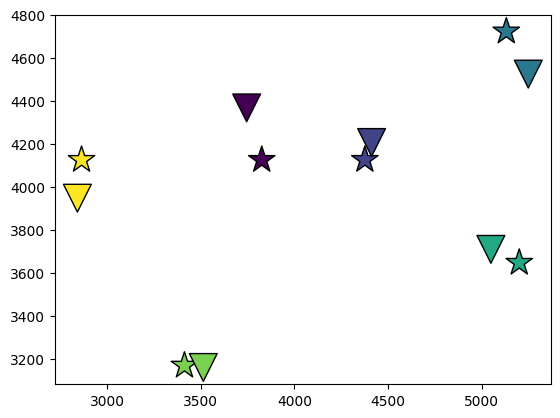

In [19]:
plt.scatter(np.array(lm3[:,0]),
            np.array(lm3[:,1]),
            c = range(lm1.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black",
            )

plt.scatter(np.array(lm1_tran[:,0]),
            np.array(lm1_tran[:,1]),
            c = range(lm1.shape[0]),
            s = 400,
            marker = "v",
            edgecolor = "black",
            )


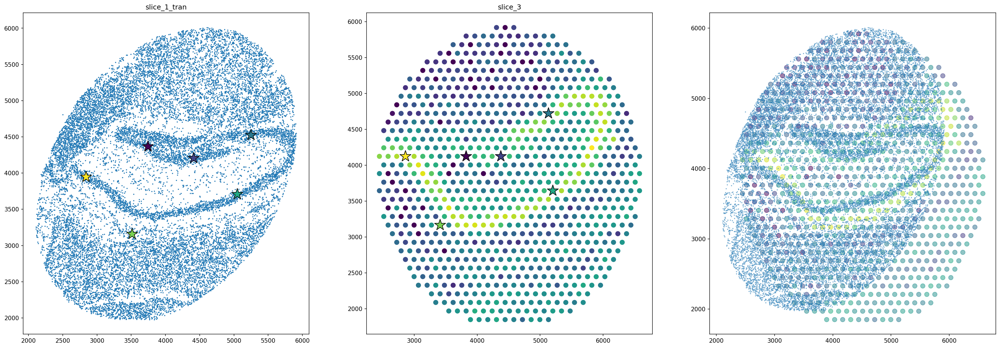

In [20]:
plt.figure(dpi=150,figsize=(30,10))
plt.subplot(1,3, 1)
plt.scatter(np.array(cor11[:,0]),
            np.array(cor11[:,1]),
            s = 1)
plt.scatter(np.array(lm1_tran[:,0]),
            np.array(lm1_tran[:,1]),
            c = range(lm1.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black",
            )
plt.title("slice_1_tran")

plt.subplot(1,3, 2)
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            s = 60,
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]]
            )
plt.scatter(lm3[:,0],
            lm3[:,1],
            c = range(lm1.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black")
plt.title("slice_3")

plt.subplot(1,3, 3)
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            alpha=0.5,
            s = 60)
plt.scatter(np.array(cor11[:,0]),
            np.array(cor11[:,1]),
            alpha=0.5,
            s = 1)

### Non-rigid alignment

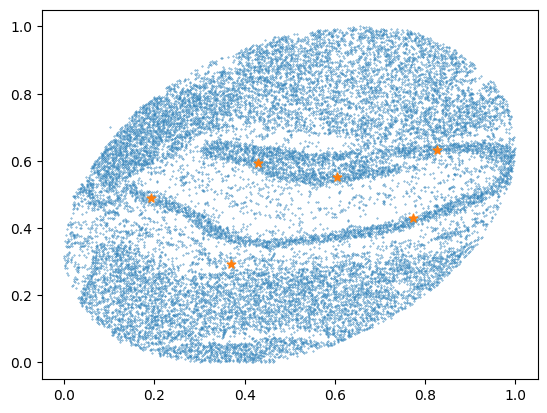

In [21]:
max1x=np.max(cor11[:,0])
min1x=np.min(cor11[:,0])
max1y=np.max(cor11[:,1])
min1y=np.min(cor11[:,1])

for i in range(cor11.shape[0]):
    cor11[i,0]=(cor11[i,0]-min1x)/(max1x-min1x)
    cor11[i,1]=(cor11[i,1]-min1y)/(max1y-min1y)
    
for i in range(lm1.shape[0]):
    lm1[i,0]=(lm1_tran[i,0]-min1x)/(max1x-min1x)
    lm1[i,1]=(lm1_tran[i,1]-min1y)/(max1y-min1y)
    
plt.scatter(cor11[:,0],cor11[:,1],s=0.1)
plt.scatter(lm1[:,0],lm1[:,1],s=40,marker="*")

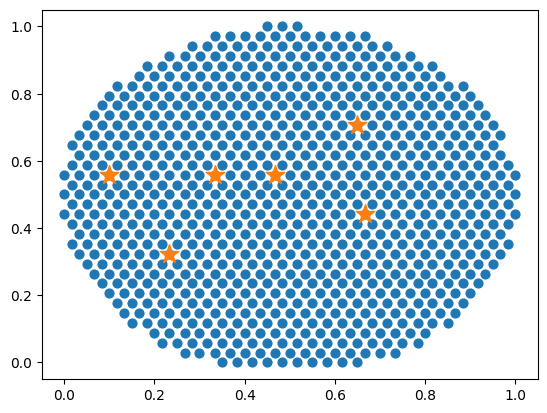

In [22]:
cor33=np.zeros(data_slice3.obsm['spatial'].shape)
max3x=np.max(data_slice3.obsm['spatial'][:,0])
min3x=np.min(data_slice3.obsm['spatial'][:,0])
max3y=np.max(data_slice3.obsm['spatial'][:,1])
min3y=np.min(data_slice3.obsm['spatial'][:,1])

x3=(data_slice3.obsm['spatial'][:,0]-min3x)/(max3x-min3x)
y3=(data_slice3.obsm['spatial'][:,1]-min3y)/(max3y-min3y)
cor33[:,0]=x3
cor33[:,1]=y3

a=np.zeros(lm3.shape)
for i in range(lm3.shape[0]):
    a[i,0]=(lm3[i,0]-min3x)/(max3x-min3x)
    a[i,1]=(lm3[i,1]-min3y)/(max3y-min3y)
lm3=a

plt.scatter(cor33[:,0],cor33[:,1],s=40)
plt.scatter(lm3[:,0],lm3[:,1],s=200,marker="*")

In [23]:
theta1 = tps.tps_theta_from_points(lm3,lm1, reduced=True)
grid1 = tps.tps_grid(theta1, lm1, (20,20))
grid1= np.swapaxes(grid1, 0, 1)

In [24]:
grid_or=np.zeros(grid1.shape)
xseq=np.linspace(0,1,20)
yseq=np.linspace(0,1,20)
for i in range(grid_or.shape[0]):
    for j in range(grid_or.shape[1]):
        grid_or[:,j,0]=xseq
        grid_or[i,:,1]=yseq

In [25]:
def b0(x):
    x=((1-x)**3)/6
    return x

def b1(x):
    x=(3*x**3-6*x**2+4)/6
    return x

def b2(x):
    x=(-3*x**3+3*x**2+3*x+1)/6
    return x

def b3(x):
    x=x**3/6
    return x

def warp(points,grid,gx,gy):
    warp_p=np.zeros(points.shape)
    for i in range(points.shape[0]):
        xleft=int(points[i,0]/gx)
        ylow=int(points[i,1]/gy)
    
        dx=points[i,0]/gx-xleft
        dy=points[i,1]/gy-ylow

        if(xleft==19):
            if(ylow==19):
                warp_p[i,:]=grid[xleft,ylow]
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft,ylow-1]*b0(dy)+grid[xleft,ylow]*b1(dy)+grid[xleft,ylow+1]*b2(dy)+grid[xleft,ylow+2]*b3(dy)
            else:
                warp_p[i,:]=grid[xleft,ylow]*(1-dy)+grid[xleft,ylow+1]*dy
            
        elif(xleft>0 and xleft<18):
            if(ylow==19):
                warp_p[i,:]=grid[xleft-1,ylow]*b0(dx)+grid[xleft,ylow]*b1(dx)+grid[xleft+1,ylow]*b2(dx)+grid[xleft+2,ylow]*b3(dx)
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft-1,ylow-1,:]*b0(dx)*b0(dy)+grid[xleft-1,ylow]*b0(dx)*b1(dy)+grid[xleft-1,ylow+1]*b0(dx)*b2(dy)+grid[xleft-1,ylow+2]*b0(dx)*b3(dy)+grid[xleft,ylow-1]*b1(dx)*b0(dy)+grid[xleft,ylow]*b1(dx)*b1(dy)+grid[xleft,ylow+1]*b1(dx)*b2(dy)+grid[xleft,ylow+2]*b1(dx)*b3(dy)+grid[xleft+1,ylow-1]*b2(dx)*b0(dy)+grid[xleft+1,ylow]*b2(dx)*b1(dy)+grid[xleft+1,ylow+1]*b2(dx)*b2(dy)+grid[xleft+1,ylow+2]*b2(dx)*b3(dy)+grid[xleft+2,ylow-1]*b3(dx)*b0(dy)+grid[xleft+2,ylow]*b3(dx)*b1(dy)+grid[xleft+2,ylow+1]*b3(dx)*b2(dy)+grid[xleft+2,ylow+2]*b3(dx)*b3(dy)
            else:
                warp_p[i,:]=grid[xleft-1,ylow]*b0(dx)*(1-dy)+grid[xleft-1,ylow+1]*b0(dx)*dy+grid[xleft,ylow]*b1(dx)*(1-dy)+grid[xleft,ylow+1]*b1(dx)*dy+grid[xleft+1,ylow]*b2(dx)*(1-dy)+grid[xleft+1,ylow+1]*b2(dx)*(dy)+grid[xleft+2,ylow]*b3(dx)*(1-dy)+grid[xleft+2,ylow+1]*b3(dx)*dy
            
        else:
            if(ylow==19):
                warp_p[i,:]=grid[xleft,ylow]*(1-dx)+grid[xleft+1,ylow]*dx
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft,ylow-1]*(1-dx)*b0(dy)+grid[xleft,ylow]*(1-dx)*b1(dy)+grid[xleft,ylow+1]*(1-dx)*b2(dy)+grid[xleft,ylow+2]*(1-dx)*b3(dy)+grid[xleft+1,ylow-1]*dx*b0(dy)+grid[xleft+1,ylow]*dx*b1(dy)+grid[xleft+1,ylow+1]*dx*b2(dy)+grid[xleft+1,ylow+2]*dx*b3(dy)
            else:
                warp_p[i,:]=grid[xleft,ylow,:]*(1-dx)*(1-dy)+grid[xleft+1,ylow,:]*dx*(1-dy)+grid[xleft+1,ylow+1,:]*dx*dy+grid[xleft,ylow+1,:]*(1-dx)*dy
            
    return warp_p
            

In [26]:
gx=grid_or[1,1,0]-grid_or[0,1,0]
gy=grid_or[1,1,1]-grid_or[1,0,1]

cor11=warp(cor11,grid1,gx,gy)
lm1=warp(lm1,grid1,gx,gy)

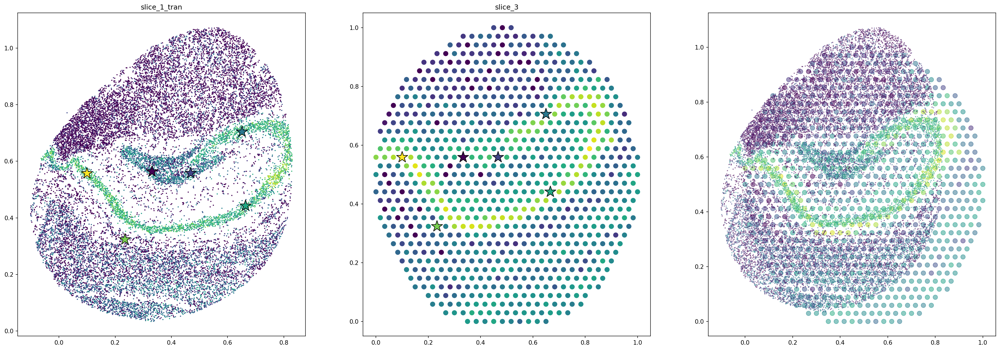

In [27]:
plt.figure(dpi=150,figsize=(30,10))
plt.subplot(1,3, 1)
plt.scatter(np.array(cor11[:,0]),
            np.array(cor11[:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            s = 1)
plt.scatter(np.array(lm1[:,0]),
            np.array(lm1[:,1]),
            c = range(lm1.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black",
            )
plt.title("slice_1_tran")

plt.subplot(1,3, 2)
plt.scatter(np.array(cor33[:,0]),
            np.array(cor33[:,1]),
            s = 60,
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]]
            )
plt.scatter(lm3[:,0],
            lm3[:,1],
            c = range(lm1.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black")
plt.title("slice_3")

plt.subplot(1,3, 3)
plt.scatter(np.array(cor33[:,0]),
            np.array(cor33[:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            alpha=0.5,
            s = 60)
plt.scatter(np.array(cor11[:,0]),
            np.array(cor11[:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            alpha=0.5,
            s = 1)

## GPR

In [28]:
x1=np.array(cor11)
x3=np.array(cor33)

x1=torch.tensor(x1).float()
x3=torch.tensor(x3).float()

y1=data_slice1.obsm['X_pca']

y1=torch.tensor(y1).float()

In [29]:
class SVGPRegressionModel(ApproximateGP):
    def __init__(self, train_x, train_y, likelihood, inducing_points):
        num_inducing = inducing_points.size(0)
        variational_distribution = CholeskyVariationalDistribution(num_inducing)
        variational_strategy = VariationalStrategy(
            self,
            inducing_points,
            variational_distribution,
            learn_inducing_locations=True
        )
        ApproximateGP.__init__(self, variational_strategy)
        
        self.mean_module = ConstantMean()
        self.covar_module = ScaleKernel(RBFKernel())
        self.inducing_points = inducing_points
        
        if likelihood is None:
            likelihood = gpytorch.likelihoods.GaussianLikelihood()

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        latent_pred = MultivariateNormal(mean_x, covar_x)
        return latent_pred


In [30]:
kmeans = KMeans(n_clusters=1000, random_state=42)
kmeans.fit(x1)

# The kmeans clustering center will be used as the induction point
inducing_points = torch.tensor(kmeans.cluster_centers_).float()

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [31]:
likelihoods1 = []
models1 = []
for i in range(y1.size(1)):
    likelihood = gpytorch.likelihoods.GaussianLikelihood()
    model = SVGPRegressionModel(x1, y1[:, i], likelihood, inducing_points)
    likelihoods1.append(likelihood)
    models1.append(model)
    


In [32]:
for model, likelihood, y in zip(models1, likelihoods1, y1.transpose(0,1)):
    model.train()
    likelihood.train()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    m11 = gpytorch.mlls.VariationalELBO(likelihood,model,len(y))
    num_epochs = 1000
    for epoch in range(num_epochs):
        optimizer.zero_grad()
        output = model(x1)
        loss = -m11(output, y)
        loss.backward()
        optimizer.step()
    

In [33]:
for model, likelihood in zip(models1, likelihoods1):
    model.eval()
    likelihood.eval()

predictions1_pca = torch.cat([model(x3).mean.unsqueeze(1) for model in models1], dim=1)


In [34]:
predictions1_pca=predictions1_pca.detach().numpy()
y_predict1_pca_all=np.dot(predictions1_pca,data_slice1.varm['PCs'].T)

In [35]:
pd.DataFrame(y_predict1_pca_all).to_csv('data_hippo/y_predict1_pca_all.csv',header=False, index=False)

In [28]:
y_predict1_pca_all=pd.read_csv('data_hippo/y_predict1_pca_all.csv',header=None)
y_predict1_pca_all=np.array(y_predict1_pca_all)

In [29]:
n_x1_3=y_predict1_pca_all.copy()
for i in range(y_predict1_pca_all.shape[1]):
    n_x1_3[:,i]=n_x1_3[:,i]-min(n_x1_3[:,i])

## Information transfer result

Text(0.5, 0.98, 'Hpca')

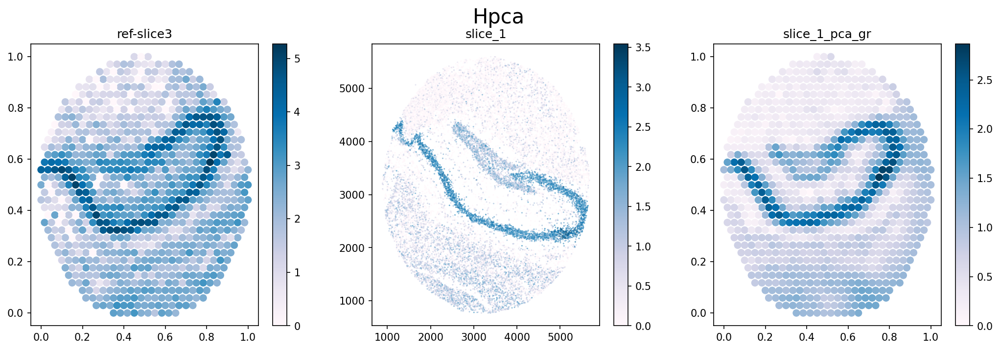

In [30]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")


plt.subplot(1,3, 2)
plt.scatter(data_slice1.obsm['spatial'][:,0],
            data_slice1.obsm['spatial'][:,1],
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s=0.1)
plt.colorbar()
plt.title("slice_1")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x1_3[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_1_pca_gr")

plt.suptitle('Hpca',fontsize=20)

Text(0.5, 0.98, 'Prkcd')

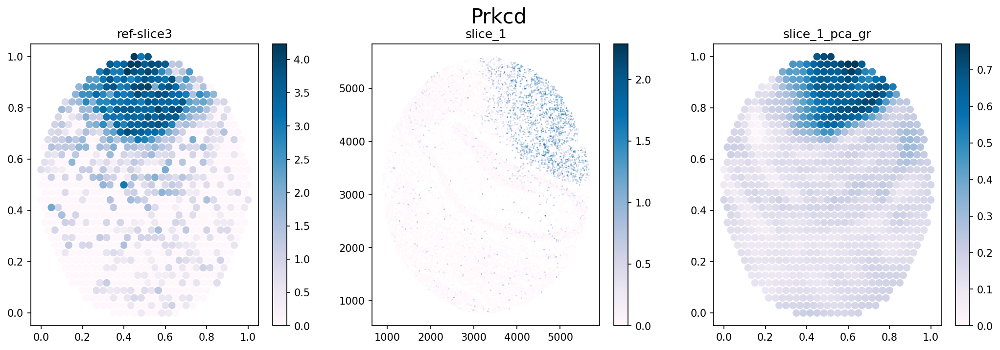

In [31]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")


plt.subplot(1,3, 2)
plt.scatter(data_slice1.obsm['spatial'][:,0],
            data_slice1.obsm['spatial'][:,1],
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Prkcd')[0][0]],
            cmap='PuBu',
            s=0.1)
plt.colorbar()
plt.title("slice_1")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x1_3[:,np.where(data_slice1.var_names=='Prkcd')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_1_pca_gr")

plt.suptitle('Prkcd',fontsize=20)

# Transfer gene information from data_slice2 to data_slice3

## Selecting landmarks

In [32]:
spatial_new2, gene2=Rasterization(data_slice2,nx=50,ny=50)
spatial_new3=data_slice3.obsm['spatial']
gene3=data_slice3.obsm['embedding']

In [33]:
cor23=np.corrcoef(gene2,gene3)[range(0,gene2.shape[0]),:][:,range(gene2.shape[0],gene2.shape[0]+gene3.shape[0])]

In [34]:
cell2_23=[]
cell3_23=[]
D=cor23.copy()
for i in range(80):
    cloc=np.where(D==np.max(cor23))
    cell2_23.append(cloc[0][0])
    cell3_23.append(cloc[1][0])
    dloc=np.where(cor23==np.max(cor23))
    cor23=np.delete(cor23, dloc[0][0], axis=0)
    cor23=np.delete(cor23, dloc[1][0], axis=1)

In [35]:
lm2_2=spatial_new2[cell2_23,:]
lm3_3=spatial_new3[cell3_23,:]

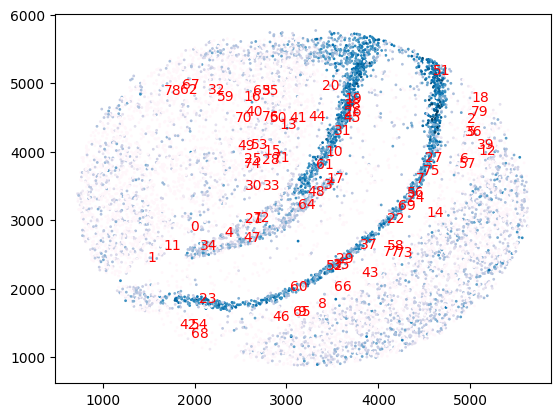

In [36]:
plt.scatter(np.array(data_slice2.obsm["spatial"][:,0]),
            np.array(data_slice2.obsm["spatial"][:,1]),
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 1)
for i in range(lm2_2.shape[0]):
    plt.text(lm2_2[i,0],lm2_2[i,1],f'{i}', c='red')

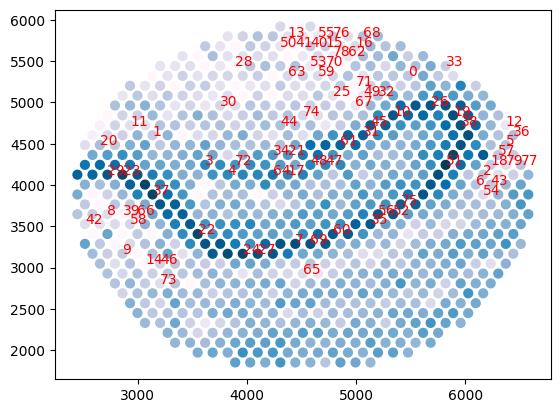

In [37]:
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
for i in range(lm3_3.shape[0]):
    plt.text(lm3_3[i,0],lm3_3[i,1],f'{i}', c='red')

In [38]:
lm50_2=lm2_2[[4,61,18,56,46,23],:]
lm50_3=lm3_3[[4,61,18,56,46,23],:]


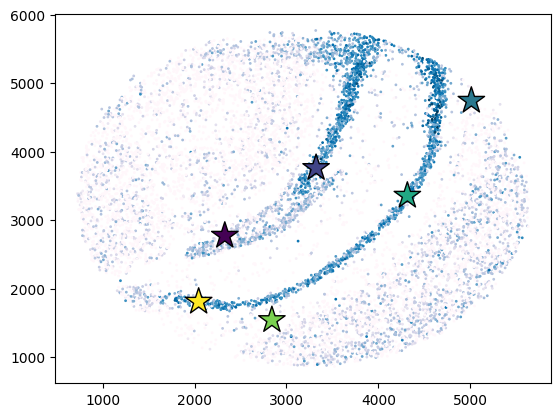

In [39]:
plt.scatter(np.array(data_slice2.obsm["spatial"][:,0]),
            np.array(data_slice2.obsm["spatial"][:,1]),
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 1)
plt.scatter(lm50_2[:,0],
            lm50_2[:,1],
            s = 400,
            c=range(lm50_2.shape[0]),
            marker = "*",
            edgecolor = "black")


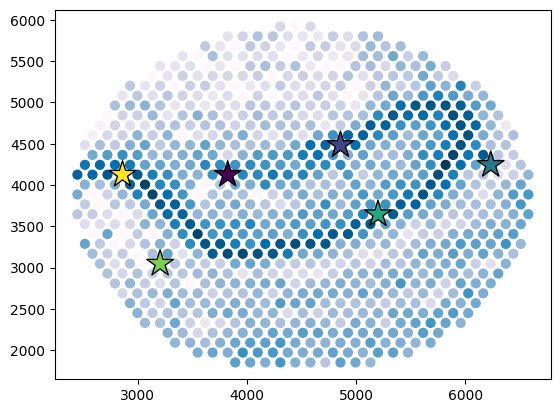

In [40]:
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
plt.scatter(lm50_3[:,0],
            lm50_3[:,1],
            s = 400,
            c=range(lm50_3.shape[0]),
            marker = "*",
            edgecolor = "black")


In [41]:
lm2=lm50_2
lm3=lm50_3

## Spatial alignmnet

### Rigid alignmnet

In [42]:
one=np.ones(lm2.shape[0])
lm2_2=np.insert(lm2,2,one,axis=1)
M2=np.dot(np.dot(np.linalg.inv(np.dot(lm2_2.T,lm2_2)),lm2_2.T),lm3)
lm2_tran=np.dot(lm2_2,M2)
cor2=np.c_[data_slice2.obsm['spatial'],np.ones(data_slice2.obsm['spatial'].shape[0])]
cor22=np.dot(cor2,M2)

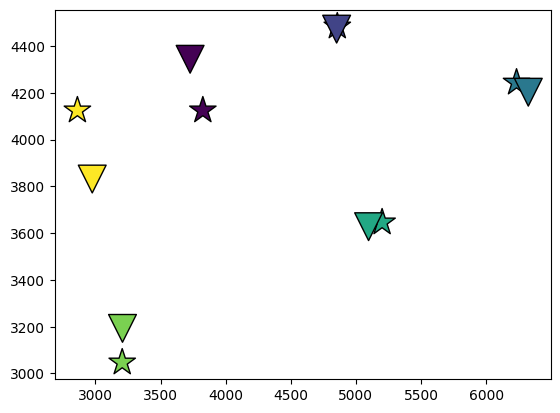

In [43]:
plt.scatter(np.array(lm3[:,0]),
            np.array(lm3[:,1]),
            c = range(lm2.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black",
            )

plt.scatter(np.array(lm2_tran[:,0]),
            np.array(lm2_tran[:,1]),
            c = range(lm2.shape[0]),
            s = 400,
            marker = "v",
            edgecolor = "black",
            )


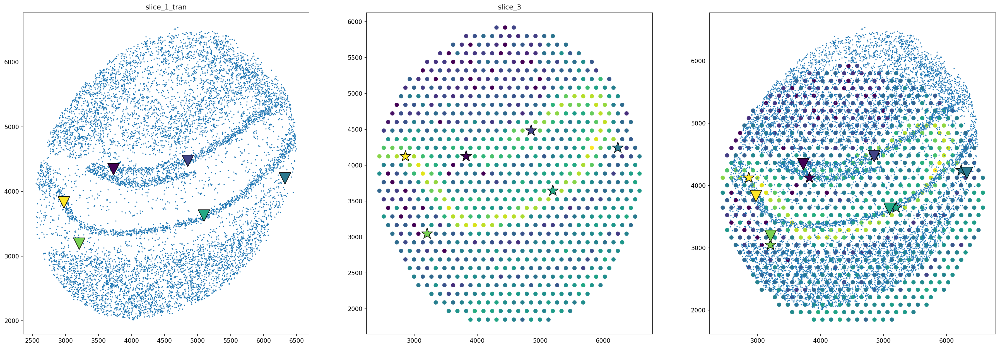

In [44]:
plt.figure(dpi=150,figsize=(30,10))
plt.subplot(1,3, 1)
plt.scatter(np.array(cor22[:,0]),
            np.array(cor22[:,1]),
            s = 1)
plt.scatter(np.array(lm2_tran[:,0]),
            np.array(lm2_tran[:,1]),
            c = range(lm2.shape[0]),
            s = 400,
            marker = "v",
            edgecolor = "black",
            )
plt.title("slice_1_tran")

plt.subplot(1,3, 2)
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            s = 40,
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]]
            )
plt.scatter(lm3[:,0],
            lm3[:,1],
            c = range(lm2.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black")
plt.title("slice_3")

plt.subplot(1,3, 3)
plt.scatter(np.array(data_slice3.obsm["spatial"][:,0]),
            np.array(data_slice3.obsm["spatial"][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.scatter(np.array(cor22[:,0]),
            np.array(cor22[:,1]),
            s = 1)
plt.scatter(np.array(lm3[:,0]),
            np.array(lm3[:,1]),
            c = range(lm2.shape[0]),
            s = 400,
            marker = "*",
            edgecolor = "black",
            )

plt.scatter(np.array(lm2_tran[:,0]),
            np.array(lm2_tran[:,1]),
            c = range(lm2.shape[0]),
            s = 400,
            marker = "v",
            edgecolor = "black",
            )

### Non-rigid alignment

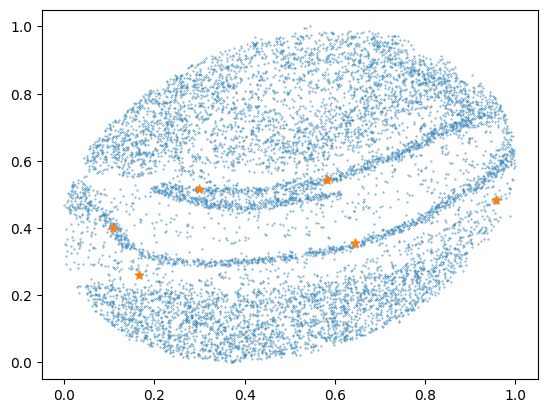

In [45]:
max2x=np.max(cor22[:,0])
min2x=np.min(cor22[:,0])
max2y=np.max(cor22[:,1])
min2y=np.min(cor22[:,1])

for i in range(cor22.shape[0]):
    cor22[i,0]=(cor22[i,0]-min2x)/(max2x-min2x)
    cor22[i,1]=(cor22[i,1]-min2y)/(max2y-min2y)
    
for i in range(lm2.shape[0]):
    lm2[i,0]=(lm2_tran[i,0]-min2x)/(max2x-min2x)
    lm2[i,1]=(lm2_tran[i,1]-min2y)/(max2y-min2y)
    
plt.scatter(cor22[:,0],cor22[:,1],s=0.1)
plt.scatter(lm2[:,0],lm2[:,1],s=40,marker="*")

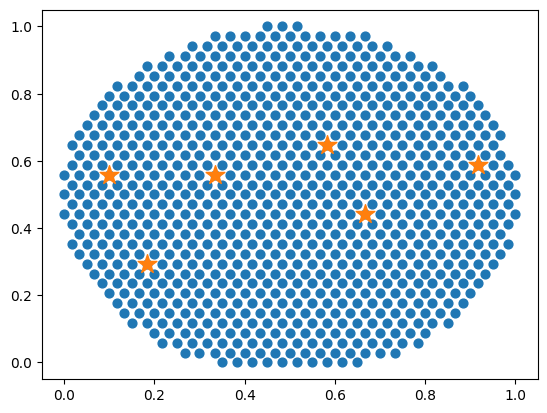

In [46]:
cor33=np.zeros(data_slice3.obsm['spatial'].shape)
max3x=np.max(data_slice3.obsm['spatial'][:,0])
min3x=np.min(data_slice3.obsm['spatial'][:,0])
max3y=np.max(data_slice3.obsm['spatial'][:,1])
min3y=np.min(data_slice3.obsm['spatial'][:,1])

x3=(data_slice3.obsm['spatial'][:,0]-min3x)/(max3x-min3x)
y3=(data_slice3.obsm['spatial'][:,1]-min3y)/(max3y-min3y)
cor33[:,0]=x3
cor33[:,1]=y3

a=np.zeros(lm3.shape)
for i in range(lm3.shape[0]):
    a[i,0]=(lm3[i,0]-min3x)/(max3x-min3x)
    a[i,1]=(lm3[i,1]-min3y)/(max3y-min3y)

lm3=a

plt.scatter(cor33[:,0],cor33[:,1],s=40)
plt.scatter(lm3[:,0],lm3[:,1],s=200,marker="*")

In [47]:
theta2 = tps.tps_theta_from_points(lm3,lm2, reduced=True)
grid2 = tps.tps_grid(theta2, lm2, (20,20))
grid2= np.swapaxes(grid2, 0, 1)

In [48]:
grid_or=np.zeros(grid2.shape)
xseq=np.linspace(0,1,20)
yseq=np.linspace(0,1,20)
for i in range(grid_or.shape[0]):
    for j in range(grid_or.shape[1]):
        grid_or[:,j,0]=xseq
        grid_or[i,:,1]=yseq

In [49]:
def b0(x):
    x=((1-x)**3)/6
    return x

def b1(x):
    x=(3*x**3-6*x**2+4)/6
    return x

def b2(x):
    x=(-3*x**3+3*x**2+3*x+1)/6
    return x

def b3(x):
    x=x**3/6
    return x

def warp(points,grid,gx,gy):
    warp_p=np.zeros(points.shape)
    for i in range(points.shape[0]):
        xleft=int(points[i,0]/gx)
        ylow=int(points[i,1]/gy)
    
        dx=points[i,0]/gx-xleft
        dy=points[i,1]/gy-ylow

        if(xleft==19):
            if(ylow==19):
                warp_p[i,:]=grid[xleft,ylow]
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft,ylow-1]*b0(dy)+grid[xleft,ylow]*b1(dy)+grid[xleft,ylow+1]*b2(dy)+grid[xleft,ylow+2]*b3(dy)
            else:
                warp_p[i,:]=grid[xleft,ylow]*(1-dy)+grid[xleft,ylow+1]*dy
            
        elif(xleft>0 and xleft<18):
            if(ylow==19):
                warp_p[i,:]=grid[xleft-1,ylow]*b0(dx)+grid[xleft,ylow]*b1(dx)+grid[xleft+1,ylow]*b2(dx)+grid[xleft+2,ylow]*b3(dx)
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft-1,ylow-1,:]*b0(dx)*b0(dy)+grid[xleft-1,ylow]*b0(dx)*b1(dy)+grid[xleft-1,ylow+1]*b0(dx)*b2(dy)+grid[xleft-1,ylow+2]*b0(dx)*b3(dy)+grid[xleft,ylow-1]*b1(dx)*b0(dy)+grid[xleft,ylow]*b1(dx)*b1(dy)+grid[xleft,ylow+1]*b1(dx)*b2(dy)+grid[xleft,ylow+2]*b1(dx)*b3(dy)+grid[xleft+1,ylow-1]*b2(dx)*b0(dy)+grid[xleft+1,ylow]*b2(dx)*b1(dy)+grid[xleft+1,ylow+1]*b2(dx)*b2(dy)+grid[xleft+1,ylow+2]*b2(dx)*b3(dy)+grid[xleft+2,ylow-1]*b3(dx)*b0(dy)+grid[xleft+2,ylow]*b3(dx)*b1(dy)+grid[xleft+2,ylow+1]*b3(dx)*b2(dy)+grid[xleft+2,ylow+2]*b3(dx)*b3(dy)
            else:
                warp_p[i,:]=grid[xleft-1,ylow]*b0(dx)*(1-dy)+grid[xleft-1,ylow+1]*b0(dx)*dy+grid[xleft,ylow]*b1(dx)*(1-dy)+grid[xleft,ylow+1]*b1(dx)*dy+grid[xleft+1,ylow]*b2(dx)*(1-dy)+grid[xleft+1,ylow+1]*b2(dx)*(dy)+grid[xleft+2,ylow]*b3(dx)*(1-dy)+grid[xleft+2,ylow+1]*b3(dx)*dy
            
        else:
            if(ylow==19):
                warp_p[i,:]=grid[xleft,ylow]*(1-dx)+grid[xleft+1,ylow]*dx
            elif(ylow>0 and ylow<18):
                warp_p[i,:]=grid[xleft,ylow-1]*(1-dx)*b0(dy)+grid[xleft,ylow]*(1-dx)*b1(dy)+grid[xleft,ylow+1]*(1-dx)*b2(dy)+grid[xleft,ylow+2]*(1-dx)*b3(dy)+grid[xleft+1,ylow-1]*dx*b0(dy)+grid[xleft+1,ylow]*dx*b1(dy)+grid[xleft+1,ylow+1]*dx*b2(dy)+grid[xleft+1,ylow+2]*dx*b3(dy)
            else:
                warp_p[i,:]=grid[xleft,ylow,:]*(1-dx)*(1-dy)+grid[xleft+1,ylow,:]*dx*(1-dy)+grid[xleft+1,ylow+1,:]*dx*dy+grid[xleft,ylow+1,:]*(1-dx)*dy
            
    return warp_p
            

In [50]:
gx=grid_or[1,1,0]-grid_or[0,1,0]
gy=grid_or[1,1,1]-grid_or[1,0,1]

cor22=warp(cor22,grid2,gx,gy)
lm2=warp(lm2,grid2,gx,gy)

Text(0.5, 1.0, 'slice_2')

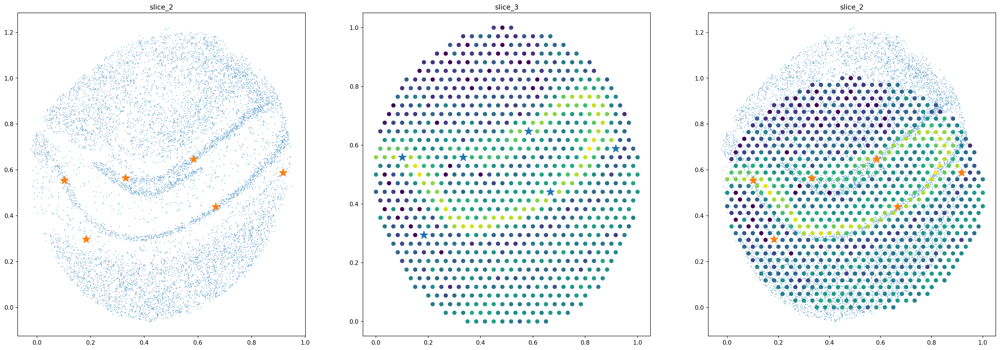

In [51]:
plt.figure(dpi=150,figsize=(30,10))
plt.subplot(1, 3, 1)
plt.scatter(cor22[:,0],cor22[:,1],s=0.1)
plt.scatter(lm2[:,0],lm2[:,1],s=200,marker="*")
plt.title("slice_2")

plt.subplot(1, 3, 2)
plt.scatter(cor33[:,0],cor33[:,1],s=40,c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]])
plt.scatter(lm3[:,0],lm3[:,1],s=200,marker="*")
plt.title("slice_3")

plt.subplot(1, 3, 3)
plt.scatter(cor22[:,0],cor22[:,1],s=0.1)
plt.scatter(cor33[:,0],cor33[:,1],s=40,c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]])
plt.scatter(lm2[:,0],lm2[:,1],s=200,marker="*")
plt.title("slice_2")


## GPR

In [54]:
x2=np.array(cor22)
x3=np.array(cor33)

x2=torch.tensor(x2).float()
x3=torch.tensor(x3).float()

y2=data_slice2.obsm['X_pca']

y2=torch.tensor(y2).float()

In [67]:
class SVGPRegressionModel(ApproximateGP):
    def __init__(self, train_x, train_y, likelihood, inducing_points):
        num_inducing = inducing_points.size(0)
        variational_distribution = CholeskyVariationalDistribution(num_inducing)
        variational_strategy = VariationalStrategy(
            self,
            inducing_points,
            variational_distribution,
            learn_inducing_locations=True
        )
        ApproximateGP.__init__(self, variational_strategy)
        
        self.mean_module = ConstantMean()
        self.covar_module = ScaleKernel(RBFKernel())
        self.inducing_points = inducing_points
        
        if likelihood is None:
            likelihood = gpytorch.likelihoods.GaussianLikelihood()

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        latent_pred = MultivariateNormal(mean_x, covar_x)
        return latent_pred


In [68]:
kmeans = KMeans(n_clusters=1000, random_state=42)
kmeans.fit(x2)

inducing_points = torch.tensor(kmeans.cluster_centers_).float()

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [69]:
likelihoods2 = []
models2 = []
for i in range(y2.size(1)):
    likelihood = gpytorch.likelihoods.GaussianLikelihood()
    model = SVGPRegressionModel(x2, y2[:, i], likelihood, inducing_points)
    likelihoods2.append(likelihood)
    models2.append(model)
    


In [70]:
for model, likelihood, y in zip(models2, likelihoods2, y2.transpose(0,1)):
    model.train()
    likelihood.train()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    m11 = gpytorch.mlls.VariationalELBO(likelihood,model,len(y))
    num_epochs = 1000
    for epoch in range(num_epochs):
        optimizer.zero_grad()
        output = model(x2)
        loss = -m11(output, y)
        loss.backward()
        optimizer.step()
    

In [71]:
for model, likelihood in zip(models2, likelihoods2):
    model.eval()
    likelihood.eval()

predictions2_pca = torch.cat([model(x3).mean.unsqueeze(1) for model in models2], dim=1)


In [72]:
predictions2_pca=predictions2_pca.detach().numpy()
y_predict2_pca_all=np.dot(predictions2_pca,data_slice2.varm['PCs'].T)
pd.DataFrame(y_predict2_pca_all).to_csv("data_hippo/y_predict2_pca_all.csv",index=False)

In [52]:
y_predict2_pca_all=np.array(pd.read_csv("data_hippo/y_predict2_pca_all.csv",header=0))

In [53]:
n_x2_3=y_predict2_pca_all.copy()
for i in range(y_predict2_pca_all.shape[1]):
    n_x2_3[:,i]=n_x2_3[:,i]-min(n_x2_3[:,i])

## Information transfer result

Text(0.5, 0.98, 'Hpca')

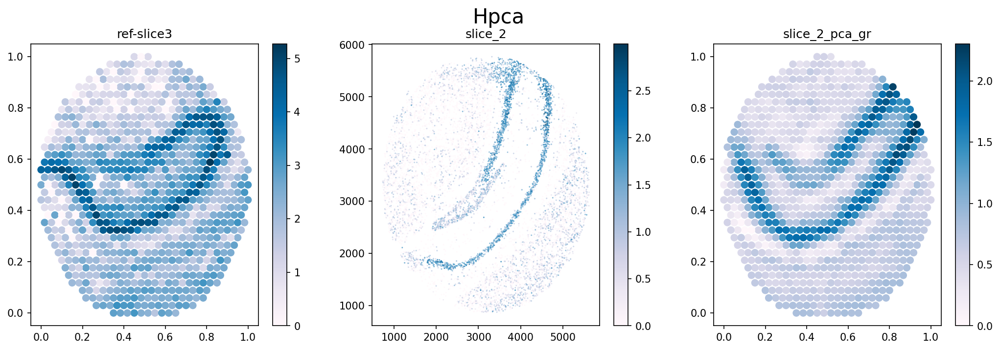

In [54]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")


plt.subplot(1,3, 2)
plt.scatter(data_slice2.obsm['spatial'][:,0],
            data_slice2.obsm['spatial'][:,1],
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s=0.1)
plt.colorbar()
plt.title("slice_2")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x2_3[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_2_pca_gr")

plt.suptitle('Hpca',fontsize=20)

Text(0.5, 0.98, 'Prkcd')

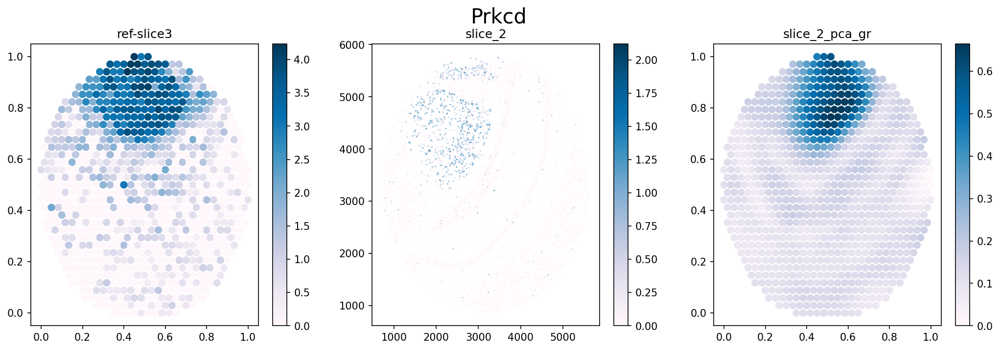

In [55]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")


plt.subplot(1,3, 2)
plt.scatter(data_slice2.obsm['spatial'][:,0],
            data_slice2.obsm['spatial'][:,1],
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Prkcd')[0][0]],
            cmap='PuBu',
            s=0.1)
plt.colorbar()
plt.title("slice_2")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x2_3[:,np.where(data_slice2.var_names=='Prkcd')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_2_pca_gr")

plt.suptitle('Prkcd',fontsize=20)

# GPR in reference(slice3)

In [ ]:
x3_3=np.array(cor33)
x3=np.array(cor33)

x3_3=torch.tensor(x3_3).float()
x3=torch.tensor(x3).float()

y3=data_slice3.obsm['X_pca']

y3=torch.tensor(y3).float()

In [ ]:
class MultiOutputGaussianProcessRegressor(gpytorch.models.ExactGP):
    def __init__(self, train_x, train_y, likelihood):
        super(MultiOutputGaussianProcessRegressor, self).__init__(train_x, train_y, likelihood)
        self.mean_module = ConstantMean()
        self.covar_module = RBFKernel()

    def forward(self, x):
        mean = self.mean_module(x)
        covar = self.covar_module(x)
        return MultivariateNormal(mean, covar)

In [ ]:
likelihoods3 = []
models3 = []
for i in range(y3.size(1)):
    likelihood = gpytorch.likelihoods.GaussianLikelihood()
    model = MultiOutputGaussianProcessRegressor(x3, y3[:, i], likelihood)
    likelihoods3.append(likelihood)
    models3.append(model) 

In [ ]:
for model, likelihood, y in zip(models3, likelihoods3, y3.transpose(0,1)):
    model.train()
    likelihood.train()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    m33 = ExactMarginalLogLikelihood(likelihood, model)
    num_epochs = 500
    for epoch in range(num_epochs):
        optimizer.zero_grad()
        output = model(x3)
        loss = -m33(output, y)
        loss.backward()
        optimizer.step()
    

In [83]:
for model, likelihood in zip(models3, likelihoods3):
    model.eval()
    likelihood.eval()

with torch.no_grad():
    predictions3_pca = torch.cat([model(x3_3).mean.unsqueeze(1) for model in models3], dim=1)

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\gpytorch\models\exact_gp.py:284: GPInputWarning: The input matches the stored training data. Did you forget to call model.train()?
  warnings.warn(


In [84]:
predictions3_pca=predictions3_pca.numpy()
y_predict3_pca_all=np.dot(predictions3_pca,data_slice3.varm['PCs'].T)
pd.DataFrame(y_predict3_pca_all).to_csv("data_hippo/y_predict3_pca_all.csv",index=False)

In [56]:
y_predict3_pca_all=np.array(pd.read_csv("data_hippo/y_predict3_pca_all.csv",header=0))

In [57]:
n_x3_3=y_predict3_pca_all.copy()
for i in range(y_predict3_pca_all.shape[1]):
    n_x3_3[:,i]=n_x3_3[:,i]-min(n_x3_3[:,i])

Text(0.5, 0.98, 'Hpca')

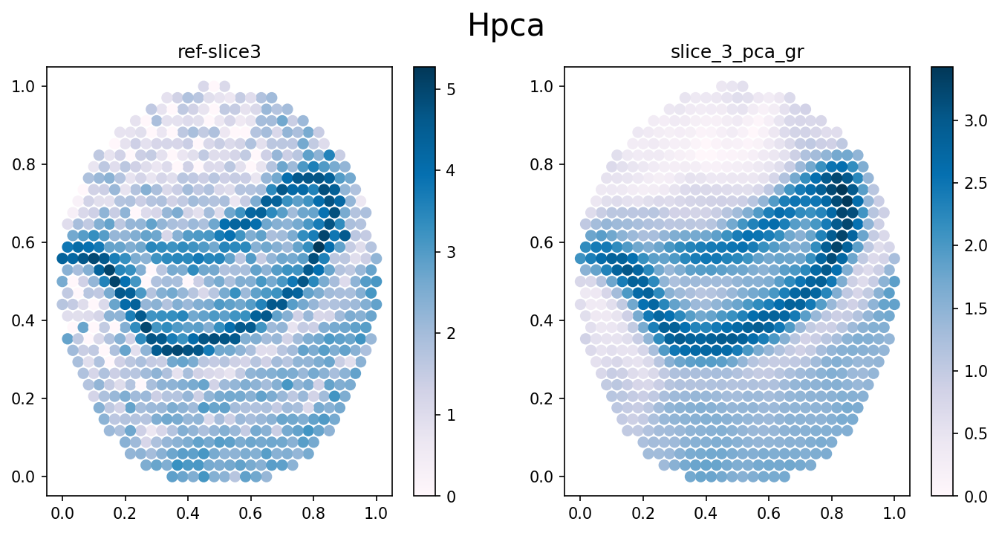

In [58]:
plt.figure(dpi=150,figsize=(11,5))
plt.subplot(1,2, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")

plt.subplot(1,2, 2)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x3_3[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_3_pca_gr")

plt.suptitle('Hpca',fontsize=20)

Text(0.5, 0.98, 'Prkcd')

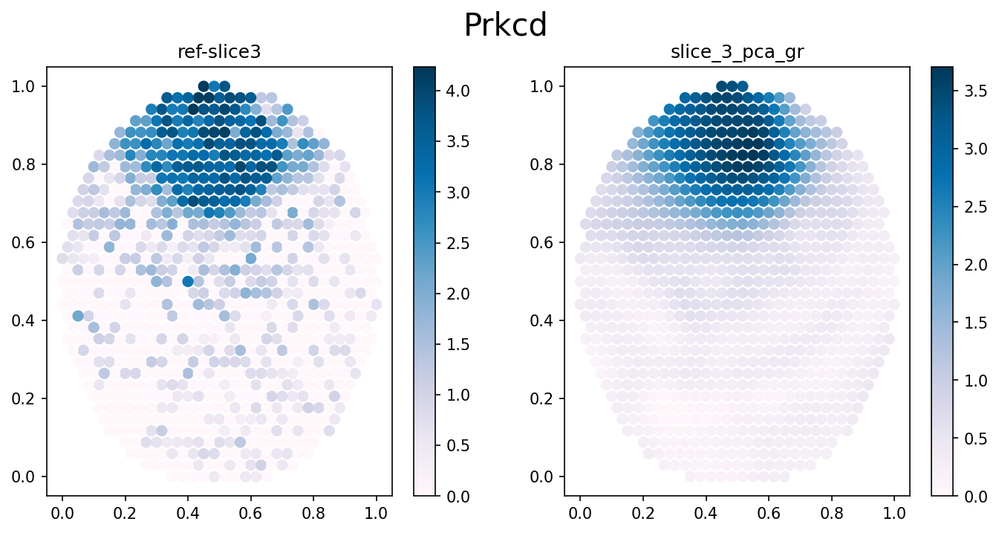

In [59]:
plt.figure(dpi=150,figsize=(11,5))
plt.subplot(1,2, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s = 40)
plt.colorbar()
plt.title("ref-slice3")

plt.subplot(1,2, 2)
plt.scatter(cor33[:,0],
            cor33[:,1],
            cmap='PuBu',
            c=n_x3_3[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s=40)
plt.colorbar()
plt.title("slice_3_pca_gr")

plt.suptitle('Prkcd',fontsize=20)

# Results presentation and downstream analysis

We first normalize the data so that this three samples can share a same dimension. Then we visualize the complete information transfer results in this case and show some common downstream analyses.

In [60]:
n_x1_3_to01=n_x1_3.copy()
n_x2_3_to01=n_x2_3.copy()
n_x3_3_to01=n_x3_3.copy()
for i in range(n_x1_3.shape[0]):
    for j in range(n_x1_3.shape[1]):
        n_x1_3_to01[i,j]=(n_x1_3[i,j]-np.min(n_x1_3[:,j]))/(np.max(n_x1_3[:,j])-np.min(n_x1_3[:,j]))
        n_x2_3_to01[i,j]=(n_x2_3[i,j]-np.min(n_x2_3[:,j]))/(np.max(n_x2_3[:,j])-np.min(n_x2_3[:,j]))
        n_x3_3_to01[i,j]=(n_x3_3[i,j]-np.min(n_x3_3[:,j]))/(np.max(n_x3_3[:,j])-np.min(n_x3_3[:,j]))

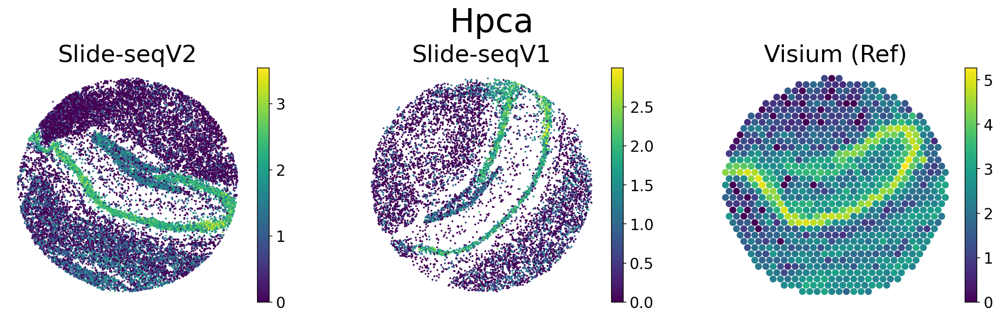

In [61]:
plt.figure(dpi=150,figsize=(19,5))
plt.subplot(1,3, 1)
plt.scatter(np.array(data_slice1.obsm['spatial'][:,0]),
            np.array(data_slice1.obsm['spatial'][:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            s = 1)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Slide-seqV2",fontsize=25)

plt.subplot(1,3,2)
plt.scatter(np.array(data_slice2.obsm['spatial'][:,0]),
            np.array(data_slice2.obsm['spatial'][:,1]),
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            s = 1)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Slide-seqV1",fontsize=25)

plt.subplot(1,3,3)
plt.scatter(np.array(data_slice3.obsm['spatial'][:,0]),
            np.array(data_slice3.obsm['spatial'][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Visium (Ref)",fontsize=25)

plt.suptitle('Hpca',fontsize=35)
plt.subplots_adjust(top=0.8)

Text(0.5, 1.0, 'slice_3_pca_gr(Hpca)')

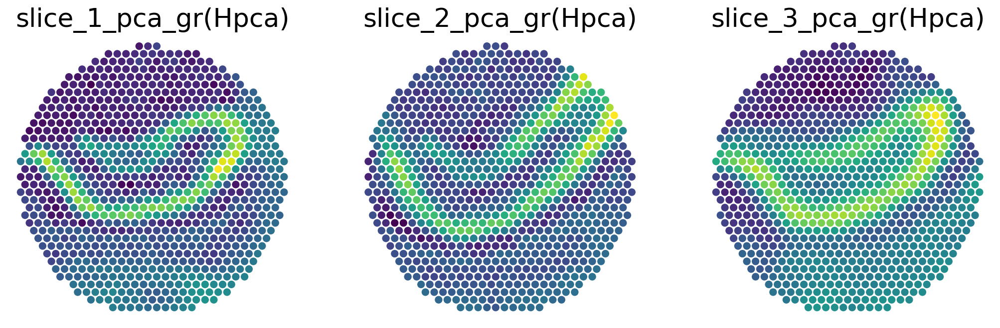

In [62]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=n_x1_3[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            s=40)
plt.axis("off")
plt.title("slice_1_pca_gr(Hpca)",fontsize=25)

plt.subplot(1,3, 2)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=n_x2_3[:,np.where(data_slice1.var_names=='Hpca')[0][0]],
            s=40)
plt.axis("off")
plt.title("slice_2_pca_gr(Hpca)",fontsize=25)

plt.subplot(1,3, 3)
plt.scatter(np.array(cor33[:,0]),
            np.array(cor33[:,1]),
            c=n_x3_3[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.axis("off")
plt.title("slice_3_pca_gr(Hpca)",fontsize=25)

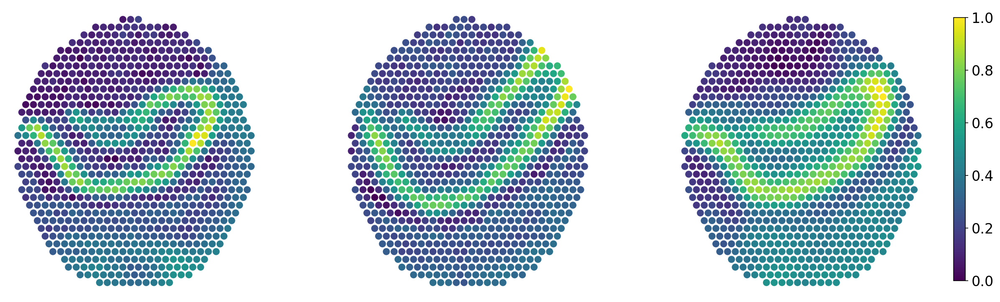

In [63]:
plt.figure(dpi=150, figsize=(19, 6))

plt.subplot(1, 3, 1)
scatter1 = plt.scatter(cor33[:, 0], cor33[:, 1], 
                     c=n_x1_3_to01[:, np.where(data_slice1.var_names == 'Hpca')[0][0]],
                     s=50)
plt.axis("off")

plt.subplot(1, 3, 2)
scatter2 = plt.scatter(cor33[:, 0], cor33[:, 1], 
                     c=n_x2_3_to01[:, np.where(data_slice2.var_names == 'Hpca')[0][0]],
                     s=50)
plt.axis("off")

plt.subplot(1, 3, 3)
scatter3 = plt.scatter(cor33[:, 0], cor33[:, 1], 
                     c=n_x3_3_to01[:, np.where(data_slice3.var_names == 'Hpca')[0][0]],
                     s=50)
plt.axis("off")

cax = plt.axes([0.92, 0.15, 0.01, 0.7])
cbar = plt.colorbar(scatter1, cax=cax)
cbar.ax.tick_params(labelsize=16)
plt.subplots_adjust(wspace=0.3)
plt.show()

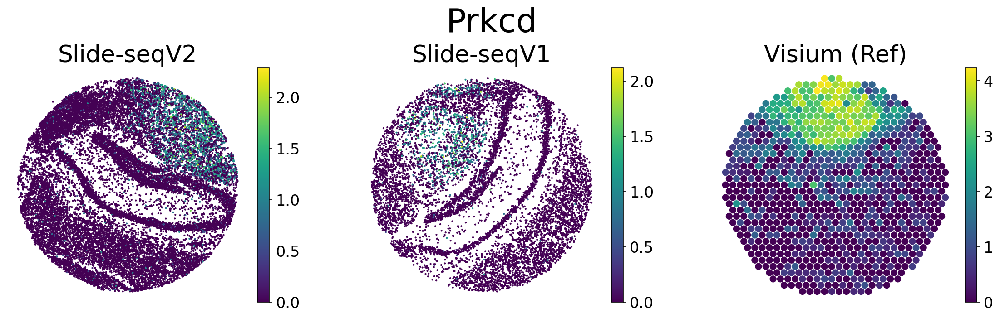

In [64]:
plt.figure(dpi=150,figsize=(19,5))
plt.subplot(1,3, 1)
plt.scatter(np.array(data_slice1.obsm['spatial'][:,0]),
            np.array(data_slice1.obsm['spatial'][:,1]),
            c=data_slice1.X[:,np.where(data_slice1.var_names=='Prkcd')[0][0]],
            s = 1)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Slide-seqV2",fontsize=25)

plt.subplot(1,3,2)
plt.scatter(np.array(data_slice2.obsm['spatial'][:,0]),
            np.array(data_slice2.obsm['spatial'][:,1]),
            c=data_slice2.X[:,np.where(data_slice2.var_names=='Prkcd')[0][0]],
            s = 1)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Slide-seqV1",fontsize=25)

plt.subplot(1,3,3)
plt.scatter(np.array(data_slice3.obsm['spatial'][:,0]),
            np.array(data_slice3.obsm['spatial'][:,1]),
            c=data_slice3.X[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s = 40)
plt.axis("off")
cbar = plt.colorbar(pad=0.03)
cbar.ax.tick_params(labelsize=16)
plt.title("Visium (Ref)",fontsize=25)

plt.suptitle('Prkcd',fontsize=35)
plt.subplots_adjust(top=0.8)

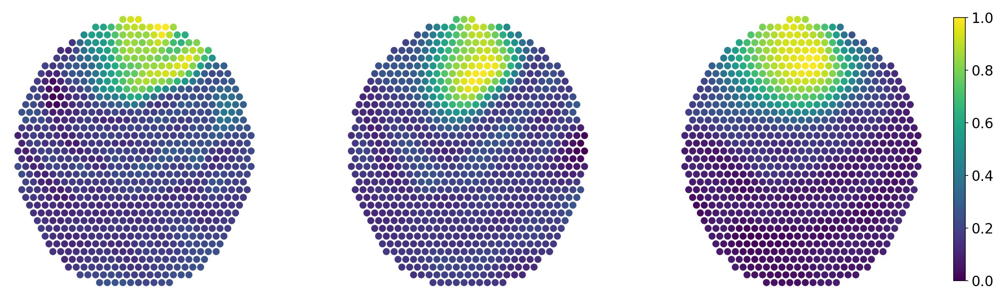

In [65]:
plt.figure(dpi=150, figsize=(19, 6))

plt.subplot(1, 3, 1)
scatter1 = plt.scatter(cor33[:, 0], cor33[:, 1],
                     c=n_x1_3_to01[:, np.where(data_slice1.var_names == 'Prkcd')[0][0]],
                     s=50)
plt.axis("off")

plt.subplot(1, 3, 2)
scatter2 = plt.scatter(cor33[:, 0], cor33[:, 1], 
                     c=n_x2_3_to01[:, np.where(data_slice2.var_names == 'Prkcd')[0][0]],
                     s=50)
plt.axis("off")

plt.subplot(1, 3, 3)
scatter3 = plt.scatter(cor33[:, 0], cor33[:, 1], 
                     c=n_x3_3_to01[:, np.where(data_slice3.var_names == 'Prkcd')[0][0]],
                     s=50)
plt.axis("off")

cax = plt.axes([0.92, 0.15, 0.01, 0.7])
cbar = plt.colorbar(scatter1, cax=cax)
cbar.ax.tick_params(labelsize=16)
plt.subplots_adjust(wspace=0.3)
plt.show()

## Average spatial expression

In [66]:
average=(n_x1_3_to01+n_x2_3_to01+n_x3_3_to01)/3

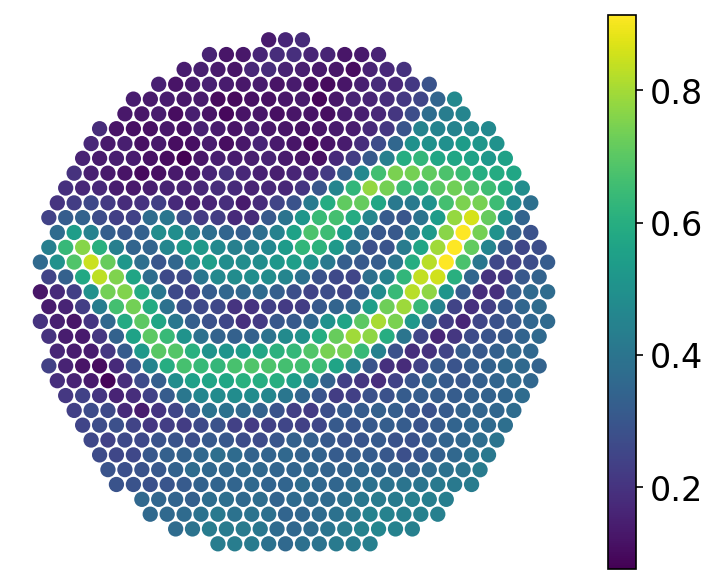

In [67]:
plt.figure(dpi=150,figsize=(6, 4.8) )
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice3.var_names=='Hpca')[0][0]],
            s = 40)
plt.axis("off")
plt.colorbar().ax.tick_params(labelsize=16)


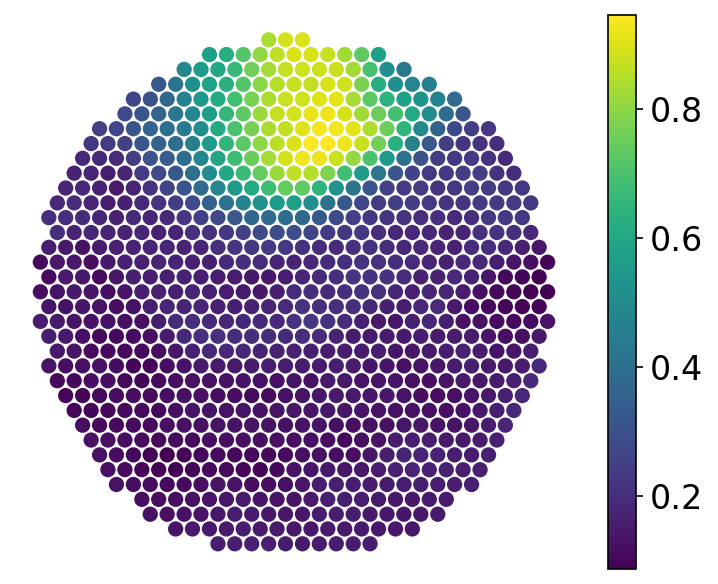

In [68]:
plt.figure(dpi=150,figsize=(6, 4.8) )
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice3.var_names=='Prkcd')[0][0]],
            s = 40)
plt.axis("off")
plt.colorbar().ax.tick_params(labelsize=16)


## Average spatial differential expression analysis

In [69]:
Hpca_minus_Prkcd=average[:,np.where(data_slice1.var_names=='Hpca')[0][0]]-average[:,np.where(data_slice1.var_names=='Prkcd')[0][0]]
percentile_20=np.percentile(Hpca_minus_Prkcd,20)
percentile_80=np.percentile(Hpca_minus_Prkcd,80)

Hpca_minus_Prkcd_to01=np.zeros(Hpca_minus_Prkcd.shape)
for i in range(Hpca_minus_Prkcd.shape[0]):
    if(Hpca_minus_Prkcd[i]<percentile_20):
        Hpca_minus_Prkcd_to01[i]=-1
    if(Hpca_minus_Prkcd[i]>percentile_80):
        Hpca_minus_Prkcd_to01[i]=1
        

Text(0.5, 1.0, 'Hpca-Prkcd')

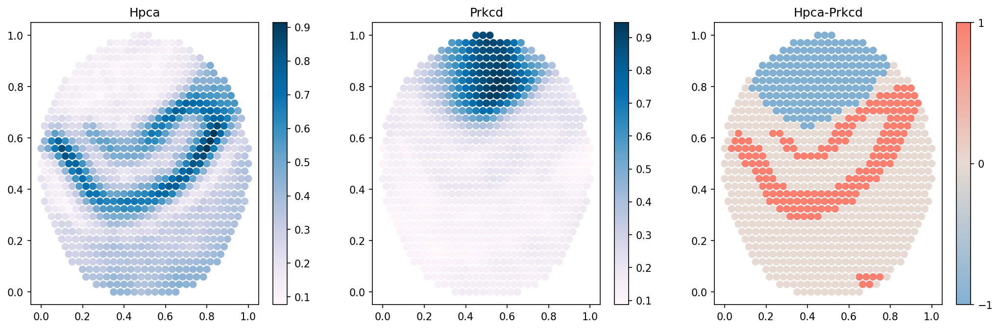

In [71]:
cmp=mpl.colors.LinearSegmentedColormap.from_list(name='cmp',colors=['#82B0D2','#E7DAD2','#FA7F6F'])

plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
plt.colorbar()
plt.title("Hpca")

plt.subplot(1,3, 2)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice2.var_names=='Prkcd')[0][0]],
            cmap='PuBu',
            s = 40)
plt.colorbar()
plt.title("Prkcd")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=Hpca_minus_Prkcd_to01,
            cmap=cmp,
            s = 40)
plt.colorbar(ticks=[-1, 0, 1])
plt.title("Hpca-Prkcd")


In [72]:
for i in range(Hpca_minus_Prkcd.shape[0]):
    if(Hpca_minus_Prkcd[i]>-Hpca_minus_Prkcd.min()):
        Hpca_minus_Prkcd[i]=-Hpca_minus_Prkcd.min()

    if(Hpca_minus_Prkcd[i]<-Hpca_minus_Prkcd.max()):
        Hpca_minus_Prkcd[i]=-Hpca_minus_Prkcd.max()


Text(0.5, 1.0, 'Hpca-Prkcd')

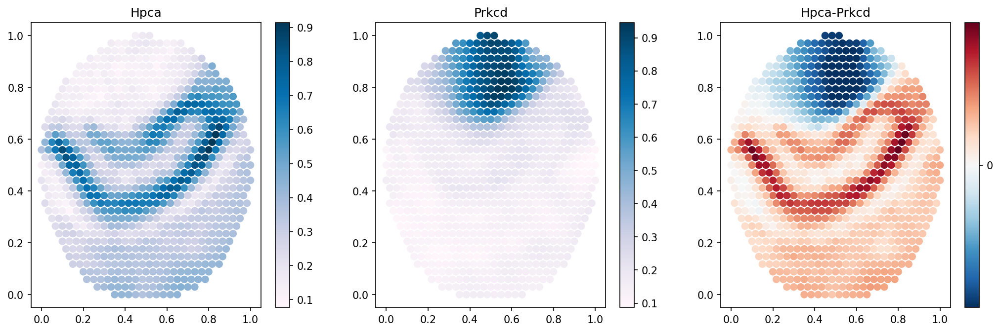

In [73]:
plt.figure(dpi=150,figsize=(17,5))
plt.subplot(1,3, 1)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice2.var_names=='Hpca')[0][0]],
            cmap='PuBu',
            s = 40)
plt.colorbar()
plt.title("Hpca")

plt.subplot(1,3, 2)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=average[:,np.where(data_slice2.var_names=='Prkcd')[0][0]],
            cmap='PuBu',
            s = 40)
plt.colorbar()
plt.title("Prkcd")

plt.subplot(1,3, 3)
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=Hpca_minus_Prkcd,
            cmap='RdBu_r',
            s = 40)
plt.colorbar(ticks=[-1, 0, 1])
plt.title("Hpca-Prkcd")

(-0.05, 1.05, -0.05, 1.05)

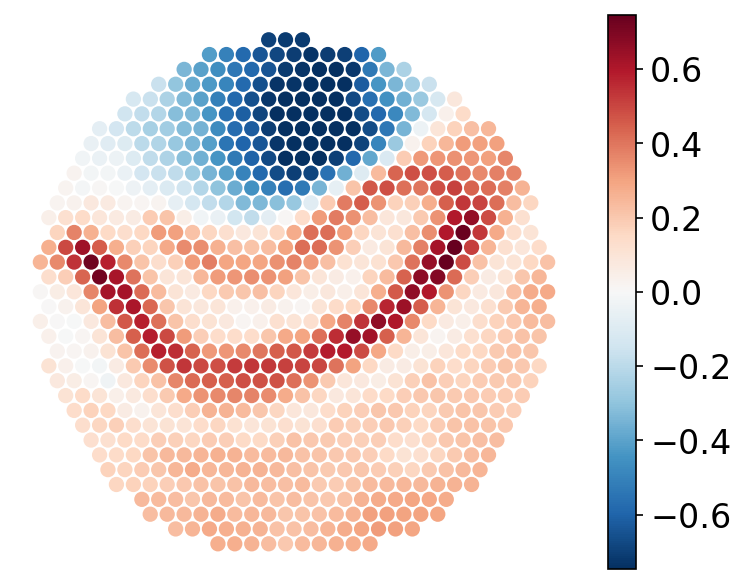

In [74]:
plt.figure(dpi=150,figsize=(6, 4.8) )
plt.scatter(cor33[:,0],
            cor33[:,1],
            c=Hpca_minus_Prkcd,
            cmap='RdBu_r',
            s = 40)
plt.colorbar().ax.tick_params(labelsize=16)
plt.axis("off")
